In [74]:
# Initialize Notebook
from IPython.core.display import HTML,Image
#%run ../library/v1.0.5/init.ipy
HTML('''<script> code_show=true;  function code_toggle() {  if (code_show){  $('div.input').hide();  } else {  $('div.input').show();  }  code_show = !code_show }  $( document ).ready(code_toggle); </script> <form action="javascript:code_toggle()"><input type="submit" value="Toggle Code"></form>''')

In [2]:
import warnings
warnings.filterwarnings('ignore')
import gc, argparse, sys, os, errno
%pylab inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt;
import seaborn as sns
#sns.set()
#sns.set_style('whitegrid')
import h5py
from PIL import Image
import os
from tqdm import tqdm_notebook as tqdm
import scipy
import sklearn
from scipy.stats import pearsonr
from scipy.io import loadmat
import IPython.display as ipd
import IPython
import librosa.display
import librosa
from pystoi import stoi

Populating the interactive namespace from numpy and matplotlib


In [4]:
from mcd import dtw
import mcd.metrics as mt
def mel_cep_dtw_dist(target, converted):
    """
    Compute the distance between two unaligned speech waveforms
    :param target: reference speech numpy array
    :param converted: synthesized speech numpy array
    :return: mel cep distance in dB
    """
    total_cost = 0
    total_frames = 0
    for (tar, conv) in zip(target, converted):
        tar, conv = tar.astype('float64'), conv.astype('float64')
        cost, _ = dtw.dtw(tar, conv, mt.logSpecDbDist)
        frames = len(tar)
        total_cost += cost
        total_frames += frames

    return total_cost / total_frames
def plot_stft(audio,ax=None,n_fft=256,hop_length=128,show=False,n_mels=128,y_axis='mel'):
    X = librosa.stft(audio,n_fft=n_fft,hop_length=hop_length)
    if y_axis=='mel':
        #x_stft_db = librosa.feature.melspectrogram(x, sr=16000,n_fft=n_fft,win_length=win_length,hop_length=hop_length)
        S = librosa.feature.melspectrogram(audio, sr=16000,n_mels=n_mels,fmax=8000,n_fft=n_fft,hop_length=hop_length)
        #print (S.shape)
        if show:
            librosa.display.specshow(librosa.power_to_db(S,
                                              ref=np.max),
                             y_axis='mel',cmap='gray_r',ax=ax, fmax=8000)
        else:
            spec_db = librosa.power_to_db(S,ref=np.max)
            #level = 80
            #spec_db[spec_db<=-level] = -100
            #spec_db[spec_db==-level] = -100
            return spec_db
    else:
        if show:
            specshow(librosa.amplitude_to_db(abs(X)),cmap=cm.Blues,#cm.gray_r,
                                      sr=16000,ax=ax)
        else:
            return librosa.amplitude_to_db(abs(X))
    
def MSE_pcc(A,B,ax=None):
    mse =np.mean(((A - B)**2/B.var()))
    pcc = pearsonr(A.ravel(),B.ravel())[0]
    return mse,pcc
def analyze(predict,GT_STFT_test_spkr,audio_pred,audio_gt,mode='test',ind=-1,plot=False,mcd=None):
    samples = predict.shape[0]
    pcc = np.zeros([samples])
    mse = np.zeros([samples])
    for i in range(samples):
        mse[i], pcc[i] = MSE_pcc(predict[i],GT_STFT_test_spkr[i])
        #mse[i], pcc[i] = MSE_pcc(predict[i] ,GT_STFT_test_spkr[i] )
    stois = []
    timedur = 0#0.06

    for i in range(samples):
        stois.append(stoi(np.concatenate((np.ones([int(interval*timedur)]),\
                audio_pred[i*interval:(i+1)*interval],np.ones([int(interval*timedur)]))), \
                          np.concatenate((np.ones([int(interval*timedur)]),\
                audio_gt[i*interval:(i+1)*interval],np.ones([int(interval*timedur)]))), 16000, extended=False))
    stois = np.array(stois)
    if plot:
        if mcd is not None:
            fig,ax=plt.subplots(1,4,figsize=(18,4))
            ax[3].hist(mcd,bins=50,color='m')
            ax[3].set_title(mode+' MCD: %g(%g)' %(np.round(mcd.mean(),3),np.round(mcd.std(),3)))
        else:
            fig,ax=plt.subplots(1,3,figsize=(20,4))
        #fig,ax=plt.subplots(1,3,figsize=(18,4))
        ax[0].hist(mse,bins=25,color='b')
        ax[0].set_title('ind '+str(ind)+' '+mode+' MSE: %g(%g)' %(np.round(mse.mean(),3),np.round(mse.std(),3)))
        ax[1].hist(pcc,bins=50,color='g')
        ax[1].set_title(mode+' PCC: %g(%g)' %(np.round(pcc.mean(),3),np.round(pcc.std(),3)))
        ax[2].hist(stois,bins=50,color='r')
        ax[2].set_title(mode+' STOI: %g(%g)' %(np.round(stois.mean(),3),np.round(stois.std(),3)))
    return mse,pcc,stois
def play(audio,sr=16000):
    '''
    audio: tensor, eg: ex['audio']
    '''
    if len(audio.shape) >=2:
        audio = audio.ravel()
    display(ipd.Audio(audio,rate=sr))
    
def amplitude(x,noise_db=-50,max_db=22.5,trim_noise=True):
   if trim_noise:
      x_db = (x+1)/2*(max_db-noise_db)+noise_db
      if type(x) is np.ndarray:
         return 10**(x_db/10)*(x_db>noise_db).astype(np.float32)
      else:
         return 10**(x_db/10)*(x_db>noise_db).float()
   else:
      return 10**(((x+1)/2*(max_db-noise_db)+noise_db)/10)
    
def log_spec_dB_dist(x, y):
    log_spec_dB_const = 10.0 / math.log(10.0) * math.sqrt(2.0)
    diff = x - y
    
    return log_spec_dB_const * math.sqrt(np.inner(diff, diff))
    
interval = 16384

In [6]:
def get_result_dict(sampleind):
    result_dict = np.load('/scratch/xc1490/projects/ecog/ALAE_1023/data/formant_result/{}.npy'.format(sampleind),allow_pickle=1).item()
    #print (result_dict.keys())
    wave_key_list = ['wave_org_denoise','wave_rec','wave_rec_denoise','wave_rec_ecog','wave_rec_ecog_denoise']
    for key in result_dict.keys():
        if key!='components' and key!='components_ecog' and key!='lable':
            #print (key)
            #print (key,result_dict[key].shape)
            if key =='org_denoise':
                result_dict[key] = amplitude(result_dict[key])
            if key =='rec_denoise' or key =='rec_ecog' or key =='rec_ecog_denoise' or key =='org' or key =='rec':
                result_dict[key] = (result_dict[key]-0.5)*2
            if key in wave_key_list:
                #print (key)
                factor = np.sqrt(sum(result_dict['wave_org']**2)/sum(result_dict[key]**2))
                result_dict[key] = result_dict[key]*factor
    for key in ['org','rec','rec_ecog','rec_ecog_denoise','rec_ecog','rec_denoise']:
        result_dict[key] = np.swapaxes(result_dict[key].reshape(256,50,-1),1,0)
    return result_dict

In [22]:
def get_metric_from_result_dict(result_dict,sample_ind=None):
    #e2a
    spec_gt = result_dict['org']
    spec_pred = result_dict['rec_ecog']
 
    wave_gt = result_dict['wave_org'][:,0,:].ravel()
    wave_pred =result_dict['wave_rec_ecog'][:819582//interval*interval].ravel()

    spec_pred_mel = np.zeros([50,32,128])
    spec_gt_mel = np.zeros([50,32,128])

    for i in  range(50):
        spec_pred_mel[i] = plot_stft(wave_pred[i*interval:(i+1)*interval],n_fft=511,hop_length=129,ax=None ,y_axis='mel',n_mels=32)
        spec_gt_mel[i] = plot_stft(wave_gt[i*interval:(i+1)*interval],n_fft=511,hop_length=129,ax=None,y_axis='mel',n_mels=32 )
    spec_concat_e2a = np.concatenate(( np.flip(spec_gt_mel,axis=1), np.flip(spec_pred_mel,axis=1)),axis=1)
    speclin_concat_e2a = np.concatenate(( np.flip(spec_gt ,axis=1), np.flip(spec_pred ,axis=1)),axis=1)
    
    mcds = []
    for i in  range(50) :
        mcds.append(mel_cep_dtw_dist(spec_pred_mel[i].T[:,1:]/10,spec_gt_mel[i].T[:,1:]/10))
    mcds = np.array(mcds)
    mcd_e2a = mcds
    
    mse_test_e2a,pcc_test_e2a,stois_test_e2a = analyze(spec_pred_mel,spec_gt_mel,wave_pred,wave_gt,plot=False,mcd=mcds)
    if sample_ind !=749:
        wave_gt_e2a = wave_gt
        wave_pred_e2a = wave_pred
    else:
        wave_gt_e2a = result_dict['wave_org_denoise'][:,0,:].ravel()#wave_gt
        wave_pred_e2a = result_dict['wave_rec_ecog_denoise'][:819582//interval*interval].ravel()#wave_pred

    
    #a2a
    spec_gt = result_dict['org']
    spec_pred = result_dict['rec']
    wave_gt = result_dict['wave_org'][:,0,:].ravel()
    wave_pred =result_dict['wave_rec'][:819582//interval*interval].ravel()

    spec_pred_mel = np.zeros([50,32,128])
    spec_gt_mel = np.zeros([50,32,128])

    for i in  range(50):
        spec_pred_mel[i] = plot_stft(wave_pred[i*interval:(i+1)*interval],n_fft=511,hop_length=129,ax=None ,y_axis='mel',n_mels=32)
        spec_gt_mel[i] = plot_stft(wave_gt[i*interval:(i+1)*interval],n_fft=511,hop_length=129,ax=None,y_axis='mel',n_mels=32 )
    spec_concat_a2a = np.concatenate(( np.flip(spec_gt_mel,axis=1), np.flip(spec_pred_mel,axis=1)),axis=1)
    speclin_concat_a2a = np.concatenate(( np.flip(spec_gt ,axis=1), np.flip(spec_pred ,axis=1)),axis=1)
    
    mcds = []
    for i in  range(50) :
        mcds.append(mel_cep_dtw_dist(spec_pred_mel[i].T[:,1:]/10,spec_gt_mel[i].T[:,1:]/10))
    mcds = np.array(mcds)
    mcd_a2a = mcds
    if sample_ind !=749:
        wave_gt_a2a = wave_gt
        wave_pred_a2a = wave_pred
    else:
        wave_gt_a2a = result_dict['wave_org_denoise'][:,0,:].ravel()#wave_gt
        wave_pred_a2a = result_dict['wave_rec_denoise'][:819582//interval*interval].ravel()#wave_pred
    
    mse_test_a2a,pcc_test_a2a,stois_test_a2a = analyze(spec_pred_mel,spec_gt_mel,wave_pred,wave_gt,plot=False,mcd=mcds)

    #mfcc e2a
    wave_gt = result_dict['wave_org'][:,0,:].ravel()
    wave_pred =result_dict['wave_rec_ecog'][:819582//interval*interval].ravel()

    spec_pred = np.zeros([50,32,33])
    spec_gt = np.zeros([50,32,33])
    mfcc_e2a = np.zeros([50])
    for i in  range(50):
        spec_pred[i] = librosa.feature.mfcc(y=wave_pred[i*interval:(i+1)*interval], sr=16000,n_mfcc=32)
        spec_gt[i] = librosa.feature.mfcc(y=wave_gt[i*interval:(i+1)*interval], sr=16000,n_mfcc=32)
        mfcc_e2a[i] = pearsonr(spec_pred[i].ravel(),spec_gt[i].ravel())[0]
    specmfcc_concat_e2a = np.concatenate(( np.flip(spec_gt,axis=1), np.flip(spec_pred,axis=1)),axis=1)
    
    #mfcc a2a
    wave_gt = result_dict['wave_org'][:,0,:].ravel()
    wave_pred =result_dict['wave_rec'][:819582//interval*interval].ravel()

    spec_pred = np.zeros([50,32,33])
    spec_gt = np.zeros([50,32,33])

    mfcc_a2a = np.zeros([50])
    for i in  range(50):
        spec_pred[i] = librosa.feature.mfcc(y=wave_pred[i*interval:(i+1)*interval], sr=16000,n_mfcc=32)
        spec_gt[i] = librosa.feature.mfcc(y=wave_gt[i*interval:(i+1)*interval], sr=16000,n_mfcc=32)
        mfcc_a2a[i] = pearsonr(spec_pred[i].ravel(),spec_gt[i].ravel())[0]
    specmfcc_concat_a2a = np.concatenate(( np.flip(spec_gt,axis=1), np.flip(spec_pred,axis=1)),axis=1)

    components_keys = ['f0','loudness', 'amplitudes', 'amplitudes_h', 'freq_formants_hamon_hz', 'bandwidth_formants_hamon_hz', 'amplitude_formants_hamon','freq_formants_noise_hz', 'bandwidth_formants_noise_hz', 'amplitude_formants_noise']
    components_pcc = {}
    for key in components_keys:
        components_pcc[key] = np.zeros([50])
        for i in range(50):
            components_pcc[key][i] =pearsonr((result_dict['components'][key][i] *(result_dict['components']['amplitudes'][i,0:1,:]  >=0.2)).ravel(),\
                            (result_dict['components_ecog'][key][i] *(result_dict['components']['amplitudes'][i,0:1,:]  >=0.2)).ravel())[0]
        #print (key,result_dict['components'][key].shape,np.mean(components_pcc[key]))
    return mse_test_e2a, pcc_test_e2a, stois_test_e2a, mcd_e2a, mfcc_e2a, \
            mse_test_a2a, pcc_test_a2a, stois_test_a2a, mcd_a2a, mfcc_a2a, components_pcc,\
            wave_gt_a2a,wave_pred_a2a, wave_gt_e2a,wave_pred_e2a, spec_concat_e2a, spec_concat_a2a,\
            specmfcc_concat_e2a,specmfcc_concat_a2a,speclin_concat_e2a,speclin_concat_a2a

In [23]:
#sample_ind = 717
sample_ind = int(os.getcwd().split('/')[-1])
result_dict = get_result_dict(sample_ind)
mse_test_e2a, pcc_test_e2a, stois_test_e2a, mcd_e2a, mfcc_e2a, \
            mse_test_a2a, pcc_test_a2a, stois_test_a2a, mcd_a2a, mfcc_a2a, components_pcc,\
            wave_gt_a2a,wave_pred_a2a, wave_gt_e2a,wave_pred_e2a, spec_concat_e2a, spec_concat_a2a,\
            specmfcc_concat_e2a,specmfcc_concat_a2a,speclin_concat_e2a,speclin_concat_a2a = get_metric_from_result_dict(result_dict,sample_ind =sample_ind)

In [15]:
select_word = np.loadtxt('/scratch/xc1490/projects/ecog/ALAE_1023/data/wordlist_NY{}.txt'.format(sample_ind),dtype='str')

# audio to audio
- gt
- prediction
- merge
- metrics
- spectrogram, waveform

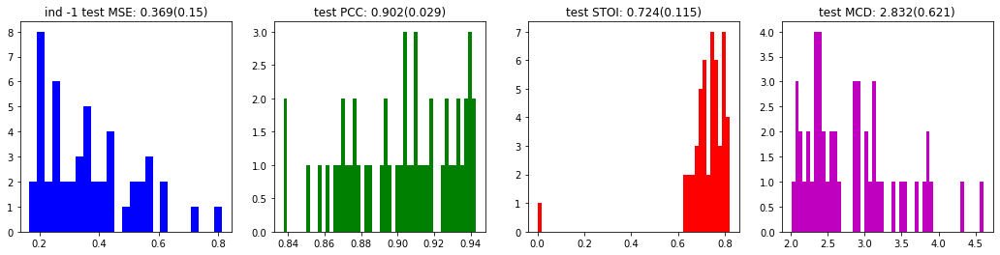

In [44]:
mse_test,pcc_test,stois_test = analyze(spec_concat_a2a[:,32:],spec_concat_a2a[:,:32],wave_gt_a2a,wave_pred_a2a,mode='test',ind=-1,plot=True,mcd=mcd_a2a)

In [16]:
wave_merge_a2a = np.concatenate(([np.concatenate((wave_gt_a2a[i*interval:(i+1)*interval],wave_pred_a2a[i*interval:(i+1)*interval]))\
                 for i in range(50)]))

In [45]:
display(ipd.Audio(wave_gt_a2a.reshape(50,-1)[np.argsort(-pcc_test)].ravel(),rate=16000))

In [46]:
display(ipd.Audio(wave_pred_a2a.reshape(50,-1)[np.argsort(-pcc_test)].ravel(),rate=16000))

In [47]:
display(ipd.Audio(wave_merge_a2a.reshape(50,-1)[np.argsort(-pcc_test)].ravel(),rate=16000))

## waveform

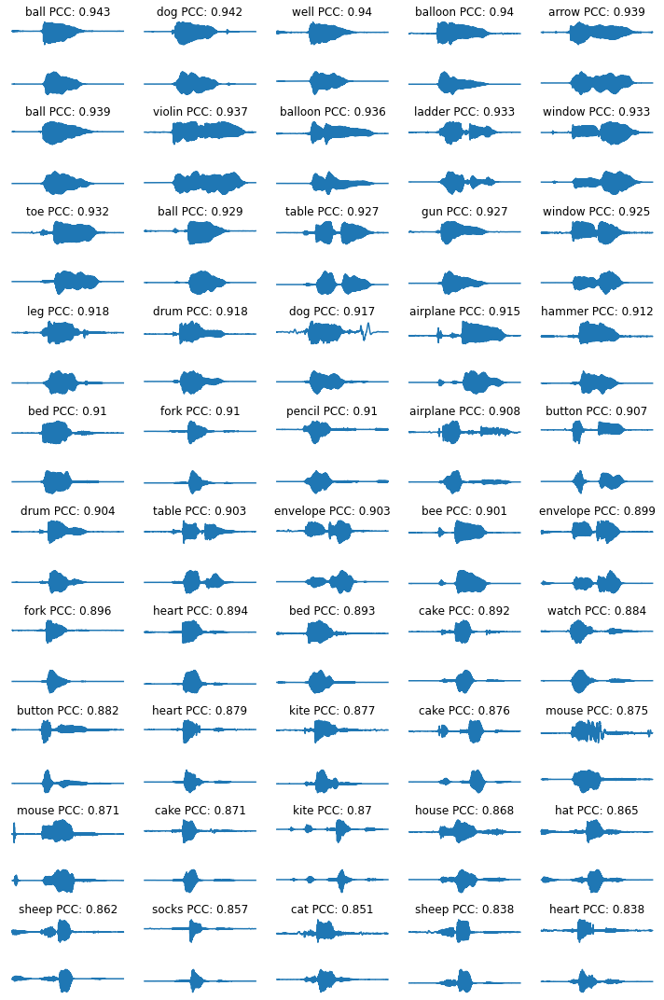

In [49]:
row_nums = 10
col_nums = 5
fig,ax=plt.subplots(row_nums*2,col_nums,figsize=(col_nums*2,row_nums*1.5))
for i in range(row_nums):
    for j in range(col_nums):
        try:
            ax[i*2,j].set_title(select_word[np.argsort(-pcc_test)[i*col_nums+j]]+' PCC: {0:.3g}'.format(-np.sort(-pcc_test)[i*col_nums+j]))
        except:
            pass
        ax[i*2,j].plot(wave_gt_a2a[(np.argsort(-pcc_test)[i*col_nums+j])*interval:(np.argsort(-pcc_test)[i*col_nums+j]+1)*interval])
        ax[i*2+1,j].plot(wave_pred_a2a[(np.argsort(-pcc_test)[i*col_nums+j])*interval:(np.argsort(-pcc_test)[i*col_nums+j]+1)*interval])
        ax[i*2,j].axis('off')
        ax[i*2+1,j].axis('off')
fig.tight_layout()

## mel spec

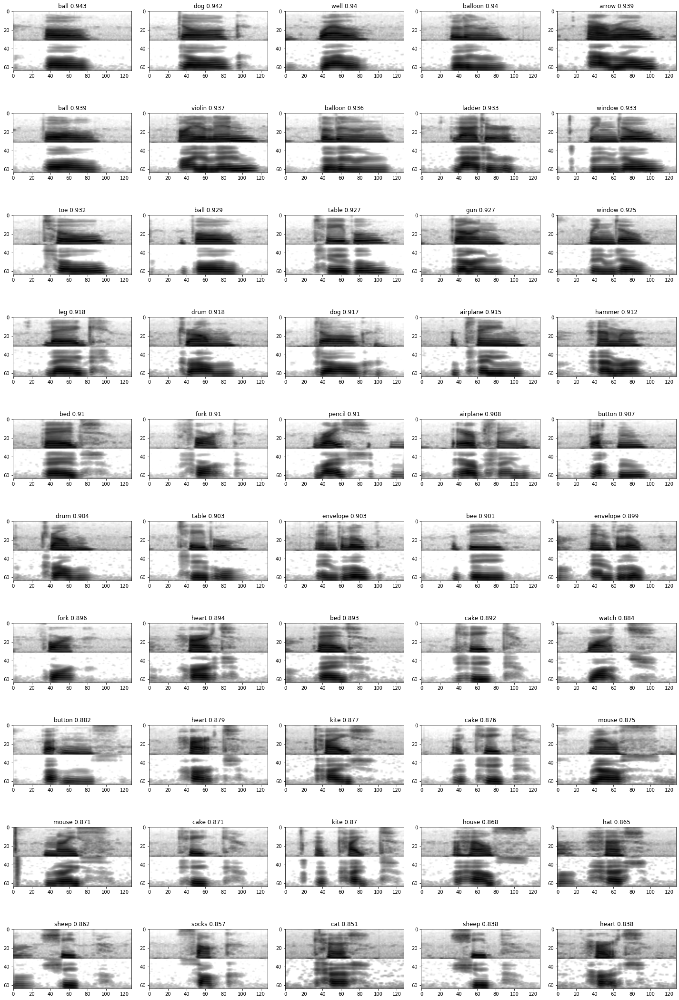

In [50]:
row_nums = 10
col_nums = 5
fig,ax=plt.subplots(row_nums,col_nums,figsize=(col_nums*4,row_nums*3))
cmap = cm.gray_r
for i in range(row_nums):
    for j in range(col_nums):
        ax[i,j].imshow(spec_concat_a2a[np.argsort(-pcc_test)[i*col_nums+j]] ,cmap=cmap)
        try:
            ax[i,j].set_title(select_word[np.argsort(-pcc_test)[i*col_nums+j]]+' {0:.3g}'.format(-np.sort(-pcc_test)[i*col_nums+j]))
        except:
            pass
plt.tight_layout()

In [25]:
spec_pred = np.zeros([50,256,128])
spec_gt = np.zeros([50,256,128])


for i in tqdm(range(50)):
    spec_pred[i] = plot_stft(wave_pred_a2a[i*interval:(i+1)*interval],n_fft=511,hop_length=129,ax=None ,y_axis='linear',n_mels=64)
    spec_gt[i] = plot_stft(wave_gt_a2a[i*interval:(i+1)*interval],n_fft=511,hop_length=129,ax=None,y_axis='linear',n_mels=64 )

spec_concat = np.concatenate(( np.flip(spec_gt,axis=1), np.flip(spec_pred,axis=1)),axis=1)

## linear spec

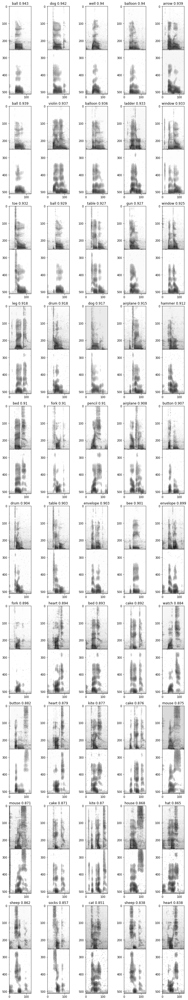

In [52]:
row_nums = 10
col_nums = 5
fig,ax=plt.subplots(row_nums,col_nums,figsize=(col_nums*2,row_nums*5))
cmap = cm.gray_r
for i in range(row_nums):
    for j in range(col_nums):
        ax[i,j].imshow(spec_concat[np.argsort(-pcc_test)[i*col_nums+j]] ,cmap=cmap)
        try:
            ax[i,j].set_title(select_word[np.argsort(-pcc_test)[i*col_nums+j]]+' {0:.3g}'.format(-np.sort(-pcc_test)[i*col_nums+j]))
        except:
            pass
plt.tight_layout()

## MFCC

In [70]:
mse_test,pcc_test,stois_test = analyze(specmfcc_concat_a2a[:,32:],specmfcc_concat_a2a[:,:32],wave_gt_a2a,wave_pred_a2a,mode='test',ind=-1,plot=False,mcd=mcd_a2a)

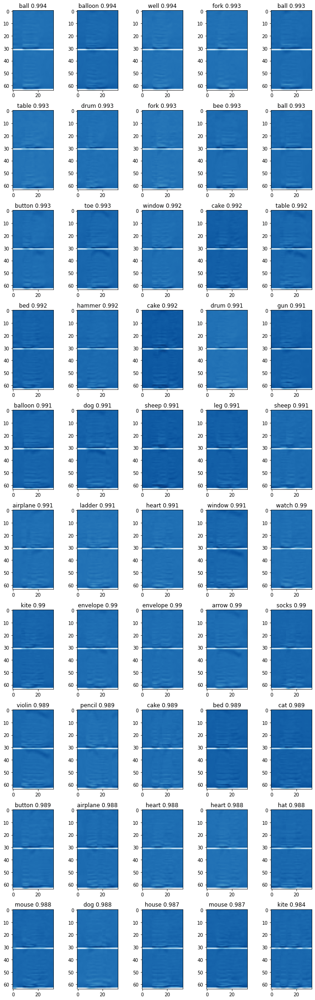

In [71]:
row_nums = 10
col_nums = 5
fig,ax=plt.subplots(row_nums,col_nums,figsize=(col_nums*2,row_nums*3))
cmap = cm.gray_r
for i in range(row_nums):
    for j in range(col_nums):
        ax[i,j].imshow(specmfcc_concat_a2a[np.argsort(-pcc_test)[i*col_nums+j]] ,cmap=cm.Blues)
        try:
            ax[i,j].set_title(select_word[np.argsort(-pcc_test)[i*col_nums+j]]+' {0:.3g}'.format(-np.sort(-pcc_test)[i*col_nums+j]))
        except:
            pass
plt.tight_layout()

# ECoG to audio
- gt
- prediction
- merge
- metrics
- spectrogram, waveform

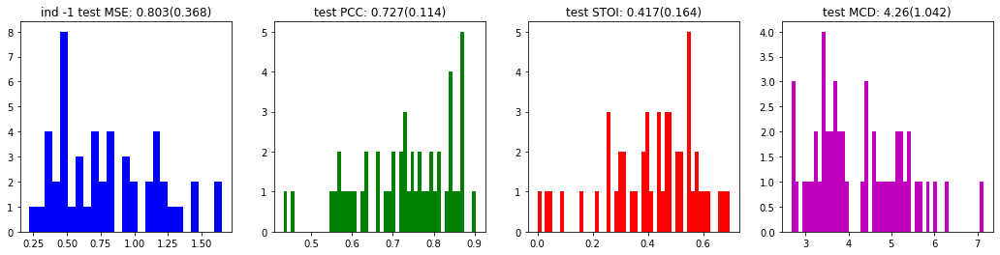

In [55]:
mse_test,pcc_test,stois_test = analyze(spec_concat_e2a[:,32:],spec_concat_e2a[:,:32],wave_gt_e2a,wave_pred_e2a,mode='test',ind=-1,plot=True,mcd=mcd_e2a)

In [56]:
wave_merge_e2a = np.concatenate(([np.concatenate((wave_gt_e2a[i*interval:(i+1)*interval],wave_pred_e2a[i*interval:(i+1)*interval]))\
                 for i in range(50)]))

In [57]:
display(ipd.Audio(wave_gt_e2a.reshape(50,-1)[np.argsort(-pcc_test)].ravel(),rate=16000))

In [59]:
display(ipd.Audio(wave_pred_e2a.reshape(50,-1)[np.argsort(-pcc_test)].ravel(),rate=16000))

In [60]:
display(ipd.Audio(wave_merge_e2a.reshape(50,-1)[np.argsort(-pcc_test)].ravel(),rate=16000))

## waveform

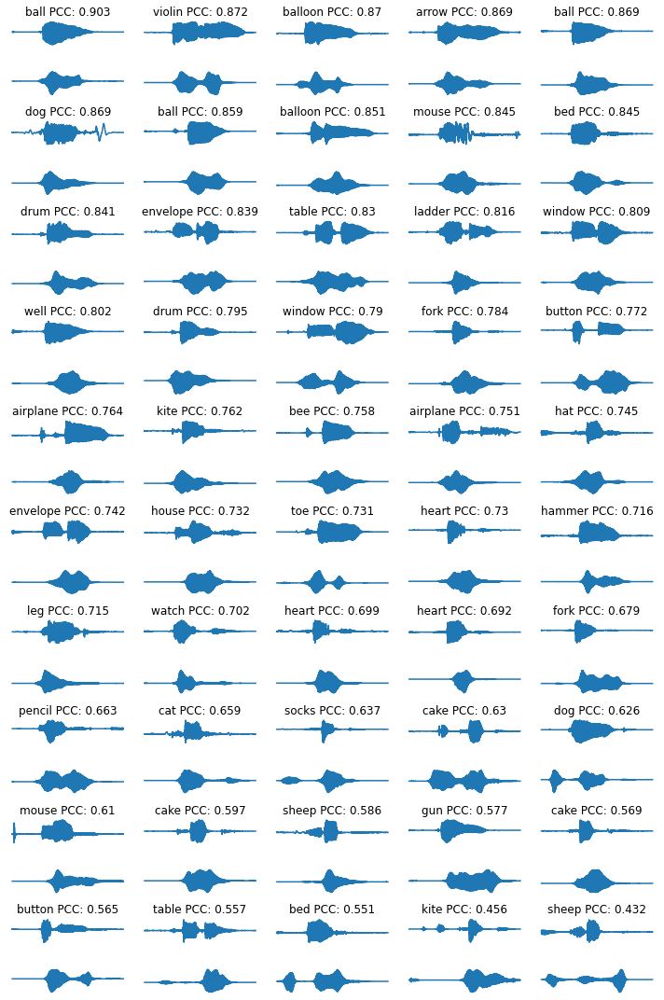

In [61]:
row_nums = 10
col_nums = 5
fig,ax=plt.subplots(row_nums*2,col_nums,figsize=(col_nums*2,row_nums*1.5))
for i in range(row_nums):
    for j in range(col_nums):
        try:
            ax[i*2,j].set_title(select_word[np.argsort(-pcc_test)[i*col_nums+j]]+' PCC: {0:.3g}'.format(-np.sort(-pcc_test)[i*col_nums+j]))
        except:
            pass
        ax[i*2,j].plot(wave_gt_e2a[(np.argsort(-pcc_test)[i*col_nums+j])*interval:(np.argsort(-pcc_test)[i*col_nums+j]+1)*interval])
        ax[i*2+1,j].plot(wave_pred_e2a[(np.argsort(-pcc_test)[i*col_nums+j])*interval:(np.argsort(-pcc_test)[i*col_nums+j]+1)*interval])
        ax[i*2,j].axis('off')
        ax[i*2+1,j].axis('off')
fig.tight_layout()

## mel spec

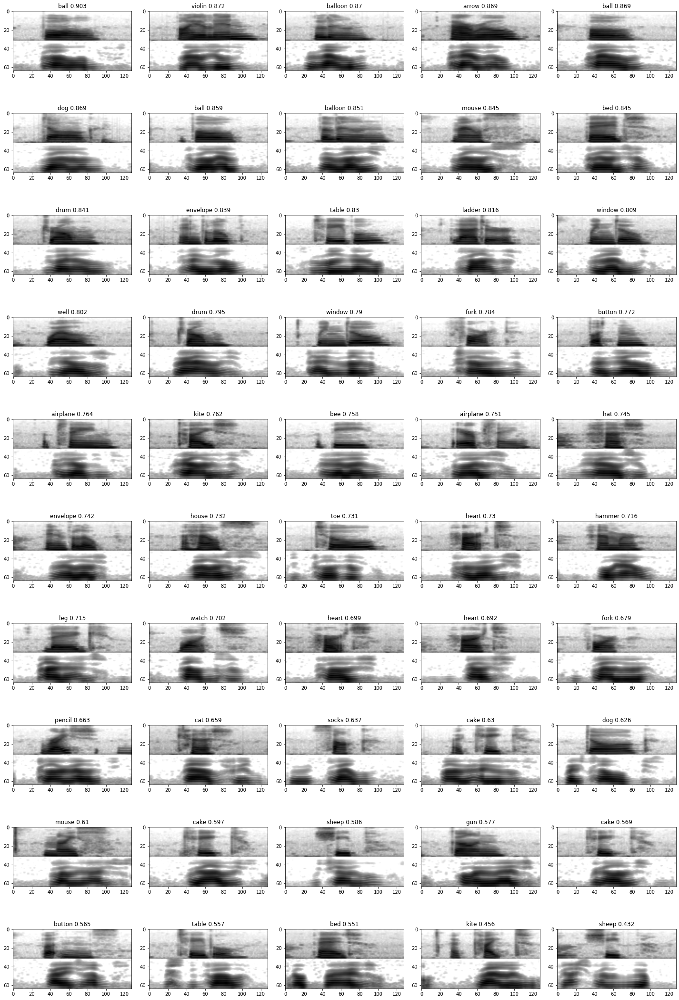

In [62]:
row_nums = 10
col_nums = 5
fig,ax=plt.subplots(row_nums,col_nums,figsize=(col_nums*4,row_nums*3))
cmap = cm.gray_r
for i in range(row_nums):
    for j in range(col_nums):
        ax[i,j].imshow(spec_concat_e2a[np.argsort(-pcc_test)[i*col_nums+j]] ,cmap=cmap)
        try:
            ax[i,j].set_title(select_word[np.argsort(-pcc_test)[i*col_nums+j]]+' {0:.3g}'.format(-np.sort(-pcc_test)[i*col_nums+j]))
        except:
            pass
plt.tight_layout()

In [65]:
spec_pred = np.zeros([50,256,128])
spec_gt = np.zeros([50,256,128])


for i in tqdm(range(50)):
    spec_pred[i] = plot_stft(wave_pred_e2a[i*interval:(i+1)*interval],n_fft=511,hop_length=129,ax=None ,y_axis='linear',n_mels=64)
    spec_gt[i] = plot_stft(wave_gt_e2a[i*interval:(i+1)*interval],n_fft=511,hop_length=129,ax=None,y_axis='linear',n_mels=64 )

spec_concat = np.concatenate(( np.flip(spec_gt,axis=1), np.flip(spec_pred,axis=1)),axis=1)

## linear spec

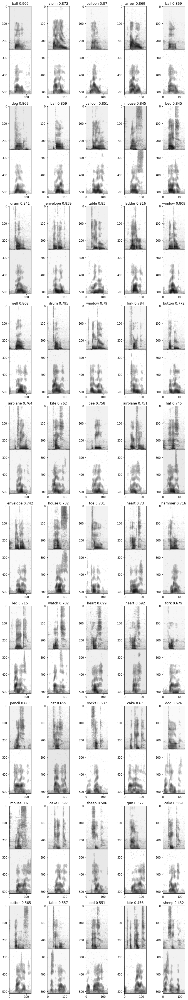

In [66]:
row_nums = 10
col_nums = 5
fig,ax=plt.subplots(row_nums,col_nums,figsize=(col_nums*2,row_nums*5))
cmap = cm.gray_r
for i in range(row_nums):
    for j in range(col_nums):
        ax[i,j].imshow(spec_concat[np.argsort(-pcc_test)[i*col_nums+j]] ,cmap=cmap)
        try:
            ax[i,j].set_title(select_word[np.argsort(-pcc_test)[i*col_nums+j]]+' {0:.3g}'.format(-np.sort(-pcc_test)[i*col_nums+j]))
        except:
            pass
plt.tight_layout()

## MFCC

In [68]:
mse_test,pcc_test,stois_test = analyze(specmfcc_concat_e2a[:,32:],specmfcc_concat_e2a[:,:32],wave_gt_e2a,wave_pred_e2a,mode='test',ind=-1,plot=False,mcd=mcd_e2a)

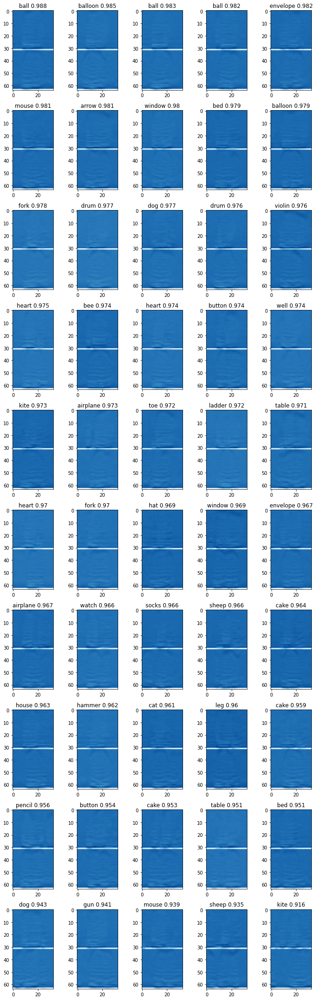

In [69]:
row_nums = 10
col_nums = 5
fig,ax=plt.subplots(row_nums,col_nums,figsize=(col_nums*2,row_nums*3))
cmap = cm.gray_r
for i in range(row_nums):
    for j in range(col_nums):
        ax[i,j].imshow(specmfcc_concat_e2a[np.argsort(-pcc_test)[i*col_nums+j]] ,cmap=cm.Blues)
        try:
            ax[i,j].set_title(select_word[np.argsort(-pcc_test)[i*col_nums+j]]+' {0:.3g}'.format(-np.sort(-pcc_test)[i*col_nums+j]))
        except:
            pass
plt.tight_layout()